In [1]:
import pandas as pd
import numpy as np
df = pd.read_csv(r"CleanedDS.csv",encoding='gbk')
df

,ETL,ETL-2,Perovskite,Perovskite_deposition_procedure,Perovskite_deposition_method,Antisolvent,Precursor_solution,HTL,HTL_additive,ETL_Passivator,...,Cs,MA,FA,Rb,Pb,Sn,I,Br,Cl,Bandgap
0,cTiO2,mTiO2,MAPbI3,one-step,spin,no,DMF,no,0,0,...,0.00,1.00,0.00,0.00,1.0,0.0,1.00,0.00,0,1.530114
1,Nb2O5,no,FA0.85MA0.15Pb(I0.85Br0.15)3,one-step,spin2-3,chlorobenzene,DMF+DMSO,Spiro-OMeTAD,Li+TBP+FK209,0,...,0.00,0.15,0.85,0.00,1.0,0.0,0.85,0.15,0,1.627177
2,TiO2,no,MAPbI3,two-step,spin-dip,no,DMF+DMSO,CuSCN,0,0,...,0.00,1.00,0.00,0.00,1.0,0.0,1.00,0.00,0,1.530114
3,no,no,MAPbI3,one-step,spin,no,DMF,PEDOT:PSS,0,0,...,0.00,1.00,0.00,0.00,1.0,0.0,1.00,0.00,0,1.530114
4,no,mTiO2,MAPbI3,two-step,spin-dip,no,DMF,no,0,0,...,0.00,1.00,0.00,0.00,1.0,0.0,1.00,0.00,0,1.530114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2780,SnO2,no,Cs0.1FA0.9PbI3,one-step,spin,chlorobenzene,DMF+DMSO,Spiro-OMeTAD,Li+TBP,HADI,...,0.10,0.00,0.90,0.00,1.0,0.0,1.00,0.00,0,1.513617
2781,cTiO2,mTiO2,FAPbI3,one-step,spin,diethylether,DMF+DMSO,Spiro-mF,Li+TBP+FK209,0,...,0.00,0.00,1.00,0.00,1.0,0.0,1.00,0.00,0,1.506078
2782,SnO2,no,FA0.94MA0.06PbI(0.94Br0.06)3,one-step,spin,chlorobenzene,DMF+DMSO,Spiro-OMeTAD,Li+TBP,0,...,0.00,0.06,0.94,0.00,1.0,0.0,0.94,0.06,0,1.517405
2783,SnO2,no,FA0.9Cs0.1PbI3,one-step,spin2-3,no,DMF+DMSO,Spiro-OMeTAD,Li+TBP,DL,...,0.10,0.00,0.90,0.00,1.0,0.0,1.00,0.00,0,1.513617


In [2]:
col_groupby = df.columns.to_list()
col_groupby.remove('PCEbest')
df1 = df.groupby(col_groupby).mean().reset_index()
df111 = df1.copy()
df1 = df1.drop(['Cl','Perovskite'],axis=1)
df1

,ETL,ETL-2,Perovskite_deposition_procedure,Perovskite_deposition_method,Antisolvent,Precursor_solution,HTL,HTL_additive,ETL_Passivator,HTL_Passivator,...,Cs,MA,FA,Rb,Pb,Sn,I,Br,Bandgap,PCEbest
0,2Dtitania,no,one-step,spin,no,DMF,Spiro-OMeTAD,Li+TBP,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,15.20
1,3TPYMB,no,two-step,CVD,no,na,PEDOT:PSS,polyTPD,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,5.50
2,ALD-SnO2,C60,one-step,spin2-3,ethylacetate,DMF+DMSO,ITONCs,0,0,0,...,0.0,0.0,1.0,0.0,0.5,0.5,1.0,0.0,1.222047,21.00
3,ALD-SnO2,C60,one-step,spin2-3,ethylacetate,DMF+DMSO,PEDOT:PSS,0,0,0,...,0.0,0.0,1.0,0.0,0.5,0.5,1.0,0.0,1.222047,18.90
4,ALD-SnO2,no,one-step,spin-spin,no,no,Spiro-OMeTAD,Li+TBP,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,19.30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1863,α‐Fe2O3,NSGQDS,one-step,spin,chlorobenzene,DMF,Spiro-OMeTAD,Li+TBP,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,19.20
1864,α‐Fe2O3,PCBM,one-step,spin,chlorobenzene,DMF,Spiro-OMeTAD,Li+TBP,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,14.20
1865,α‐Fe2O3,m-α‐Fe2O3,one-step,spin2-3,toluene,DMF+DMSO,Spiro-OMeTAD,Li+TBP,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,18.10
1866,α‐Fe2O3,no,one-step,spin,chlorobenzene,DMF,Spiro-OMeTAD,Li+TBP,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,13.15


In [3]:
from sklearn import preprocessing
for i in ['ETL', 'ETL-2', 'Perovskite_deposition_procedure',
       'Perovskite_deposition_method', 'Antisolvent', 'Precursor_solution',
       'HTL', 'HTL_additive', 'ETL_Passivator', 'HTL_Passivator', 'Additive',
       'Use_Cl']:
    lbl = preprocessing.LabelEncoder()
    df1[i] = lbl.fit_transform(df1[i].astype('str'))
df1

,ETL,ETL-2,Perovskite_deposition_procedure,Perovskite_deposition_method,Antisolvent,Precursor_solution,HTL,HTL_additive,ETL_Passivator,HTL_Passivator,...,Cs,MA,FA,Rb,Pb,Sn,I,Br,Bandgap,PCEbest
0,0,105,0,23,30,2,179,25,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,15.20
1,1,105,1,0,30,85,113,58,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,5.50
2,2,13,0,35,25,14,62,0,0,0,...,0.0,0.0,1.0,0.0,0.5,0.5,1.0,0.0,1.222047,21.00
3,2,13,0,35,25,14,113,0,0,0,...,0.0,0.0,1.0,0.0,0.5,0.5,1.0,0.0,1.222047,18.90
4,2,105,0,33,30,86,179,25,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,19.30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1863,141,32,0,23,5,2,179,25,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,19.20
1864,141,40,0,23,5,2,179,25,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,14.20
1865,141,82,0,35,32,14,179,25,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,18.10
1866,141,105,0,23,5,2,179,25,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.530114,13.15


In [4]:
Y = df1['PCEbest']
X = df1.drop(['PCEbest'],axis=1)

R2 =  0.9530826695962255
MSE =  1.4037043838331689
------------------------------------------
mean of residuals 0.031359441093822125
std of residuals 1.1846823594468932
------------------------------------------
find 50 outliers： 
[28, 29, 55, 83, 104, 129, 166, 172, 200, 250, 251, 297, 362, 398, 414, 433, 440, 452, 572, 767, 779, 799, 891, 980, 998, 1045, 1103, 1137, 1138, 1177, 1204, 1214, 1269, 1273, 1275, 1279, 1302, 1319, 1325, 1351, 1459, 1461, 1469, 1503, 1605, 1646, 1820, 1851, 1854, 1855]
R2 =  0.8308669680429462
MSE =  5.060236300017863
------------------------------------------
mean of residuals -1.3287903779443328e-08
std of residuals 2.2500992548997854
------------------------------------------
find 48 outliers： 
[28, 83, 111, 124, 166, 180, 200, 221, 250, 297, 349, 362, 398, 440, 511, 572, 767, 779, 848, 884, 886, 980, 998, 1046, 1069, 1137, 1138, 1177, 1214, 1221, 1255, 1269, 1273, 1275, 1351, 1372, 1458, 1461, 1513, 1558, 1605, 1618, 1678, 1701, 1825, 1835, 1838, 1854]


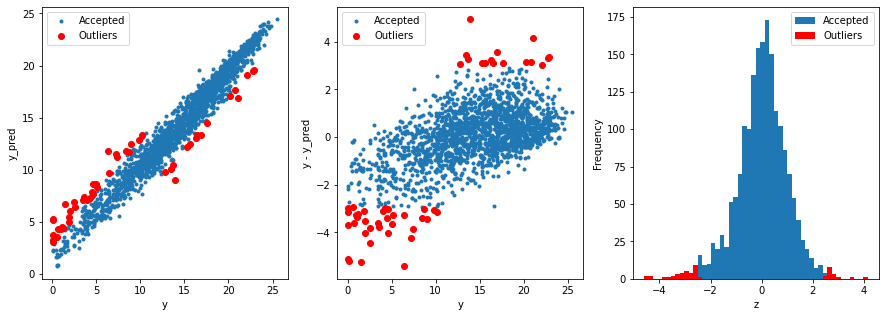

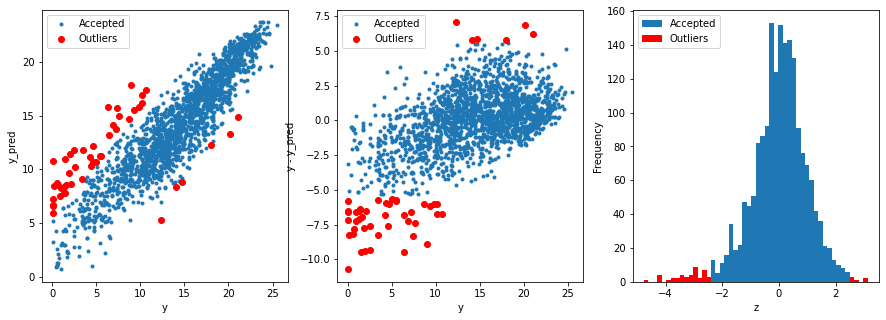

In [5]:
from letsplot import find_outliers
from lightgbm import LGBMRegressor
import numpy as np
from sklearn.ensemble import RandomForestRegressor

outliers1 = find_outliers(RandomForestRegressor(), X, Y, 2.5)
outliers2 = find_outliers(LGBMRegressor(), X, Y, 2.5)

In [6]:
colsee = ['PCEbest','Perovskite','ETL', 'ETL-2', 'Perovskite_deposition_procedure',
       'Perovskite_deposition_method', 'Antisolvent', 'Precursor_solution',
       'HTL', 'HTL_additive', 'ETL_Passivator', 'HTL_Passivator', 'Additive',
       'Use_Cl']
df111.loc[outliers1&outliers2,colsee]

C:\Users\HIT\AppData\Local\Temp/ipykernel_11368/839953030.py:5: FutureWarning: Index.__and__ operating as a set operation is deprecated, in the future this will be a logical operation matching Series.__and__.  Use index.intersection(other) instead
  df111.loc[outliers1&outliers2,colsee]


,PCEbest,Perovskite,ETL,ETL-2,Perovskite_deposition_procedure,Perovskite_deposition_method,Antisolvent,Precursor_solution,HTL,HTL_additive,ETL_Passivator,HTL_Passivator,Additive,Use_Cl
28,10.18,Cs0.05MA0.12FA0.83Pb(I0.85Br0.15)3,BCP,C60,one-step,spin2-3,toluene,DMF+DMSO,TPT-H6,0,0,0,0,0
83,6.35,MA0.6FA0.4PbI3,BCP,PCBM,one-step,spin2-3,chlorobenzene,DMF+DMSO,NiOx/PTAA,0,0,0,0,0
166,1.50,MAPbI3,CdS,mAl2O3,two-step,spin-dip,no,DMF,Spiro-OMeTAD,Li+TBP,0,0,0,0
200,0.10,FA0.85MA0.15Pb(I0.85Br0.15)3,Nb2O5,no,one-step,spin2-3,chlorobenzene,DMF+DMSO,Spiro-OMeTAD,Li+TBP+FK209,0,0,0,0
250,0.10,MAPbI3,PCBM,BCP,one-step,spin,no,DMF,no,0,0,0,0,0
297,2.60,MAPbI3,PCBM,Ca,one-step,spin,toluene,DMF,PEDOT:PSS,0,0,0,0,0
362,1.90,MAPbI3,PCBM,no,one-step,spin,0,DMF,PEDOT:PSS,0,0,0,0,0
398,2.50,MAPbI3,PCBM,no,one-step,spin,no,DMF,Spiro-OMeTAD,Li+TBP,0,0,0,Cl
440,0.10,MAPbI3,PCBM,no,one-step,spin2-3,no,GBL,NiOx,0,0,0,0,0
572,9.00,FA0.95Cs0.05PbI3,SnO2,ZnO,one-step,spin,chlorobenzene,DMF+DMSO,Spiro-OMeTAD,Li+TBP+FK209,0,0,5-AVAI,0


In [7]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state= 4156)

Train R2: 0.4955517114210648
Train RMSE: 3.898965244124344
Train MAE: 3.0211971414457683
Test MAE: 2.971896384609989


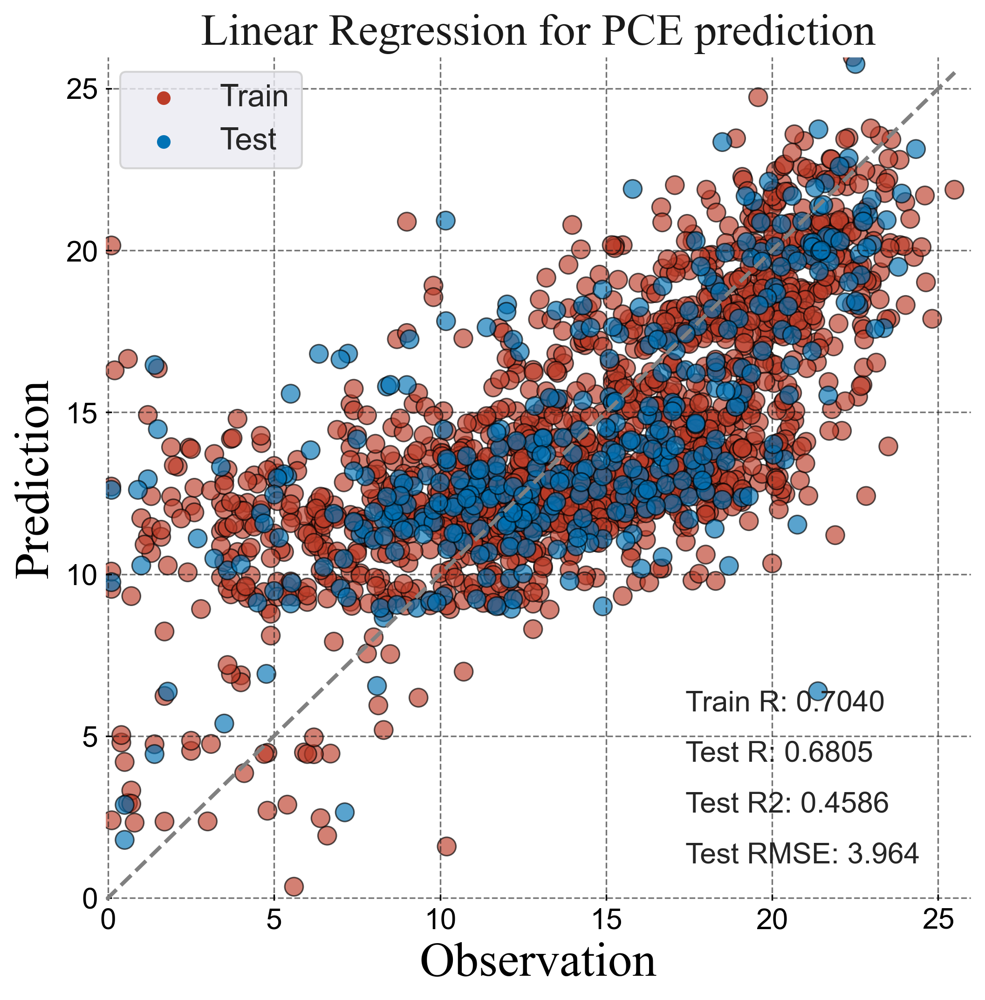

In [8]:
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from letsplot import myscatterplot,save_arrays_with_nan
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt

# Linear Regression Model

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2)
std = StandardScaler()
x_train = std.fit_transform(X_train)
x_test = std.transform(X_test)

lr = LinearRegression()
lr.fit(x_train, y_train)

y_test_hat_lr = lr.predict(x_test)
y_train_hat_lr = lr.predict(x_train)

myscatterplot(y_train, y_train_hat_lr, y_test, y_test_hat_lr, 'Linear Regression', plot_height=8, picname='LR noYear')
# save_arrays_with_nan(y_train.values,y_train_hat_lr,y_test.values,y_test_hat_lr,'LR')

### NNM

d:\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Train R2: 0.7011610066913772
Train RMSE: 3.000956289470633
Train MAE: 2.22731942735672
Test MAE: 2.8601743345718593


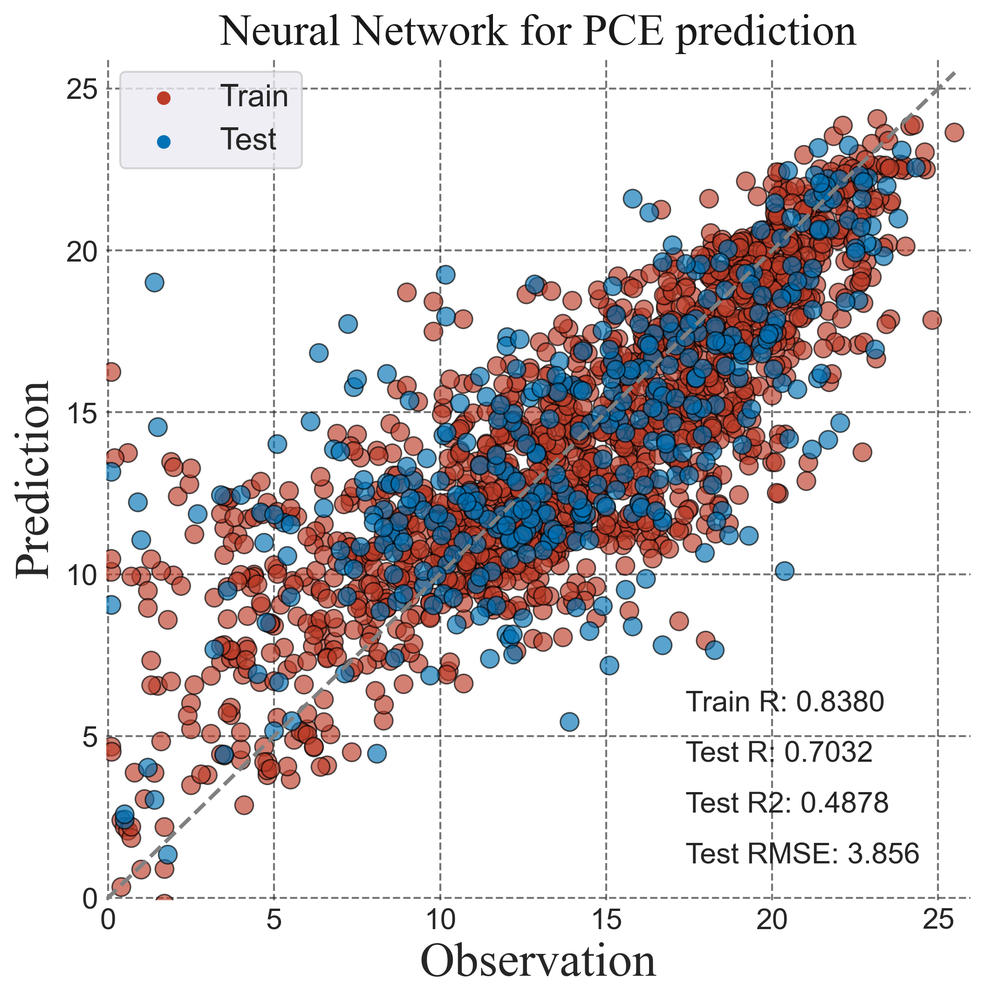

In [9]:
# Neural Network Model
nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)

# std=StandardScaler()
# x_train=std.fit_transform(X_train)
# x_test=std.transform(X_test)

nn.fit(x_train, y_train)
y_test_hat_nn = nn.predict(x_test)
y_train_hat_nn = nn.predict(x_train)
myscatterplot(y_train, y_train_hat_nn, y_test, y_test_hat_nn, 'Neural Network', plot_height=8, picname='NN noYear')

d:\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best parameters: {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (500,), 'learning_rate': 'constant', 'solver': 'sgd'}
Train R2: 0.8295934578586871
Train RMSE: 2.2661266037304624
Train MAE: 1.6071660675076875
Test MAE: 2.8755295588333936


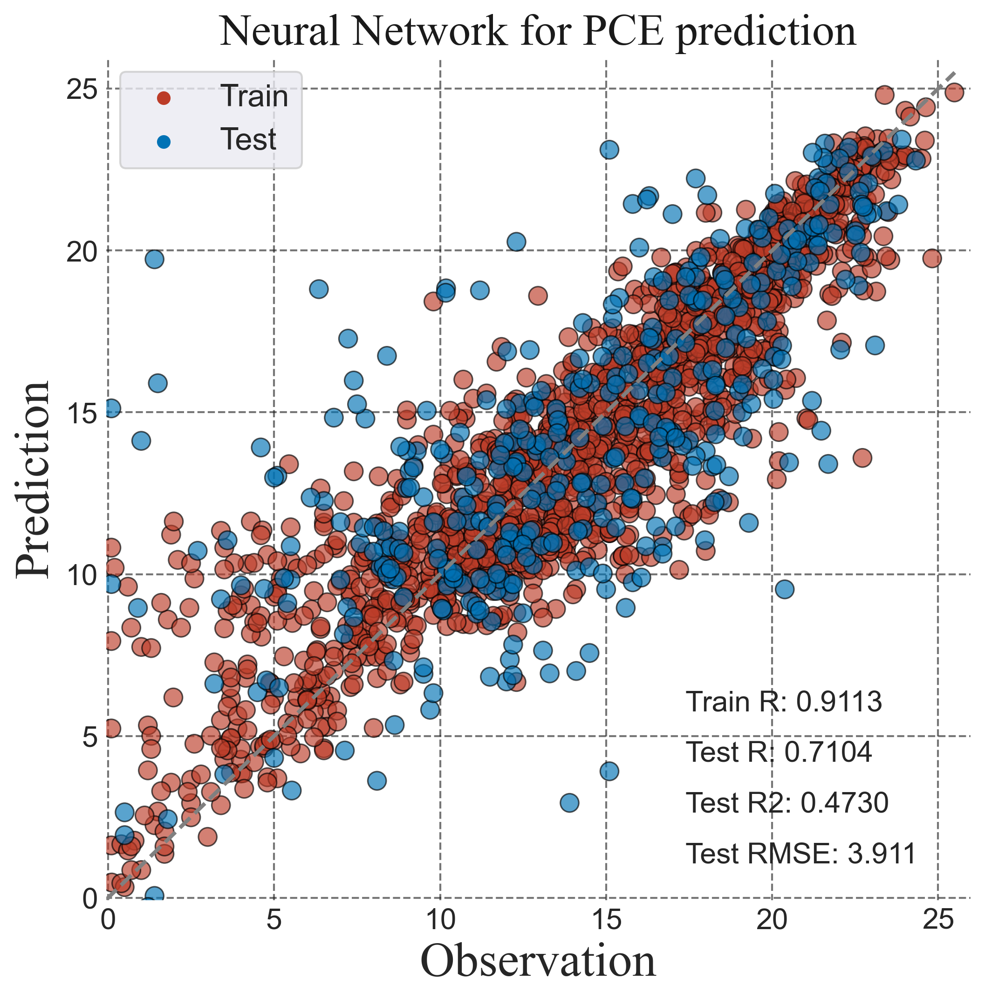

In [10]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

# MLPRegressor
param_grid = {
    'hidden_layer_sizes': [(100,), (200,), (500,), (100, 50)],
    'activation': ['tanh', 'relu'],
    'solver': ['adam', 'sgd'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'adaptive']
}

nn = MLPRegressor(max_iter=1000, random_state=42)
grid_search_nn = GridSearchCV(estimator=nn, param_grid=param_grid, cv=5, n_jobs=-1)


grid_search_nn.fit(x_train, y_train)

# Get the best model
best_nn = grid_search_nn.best_estimator_
print("Best parameters:", grid_search_nn.best_params_)

y_test_hat_nn = best_nn.predict(x_test)
y_train_hat_nn = best_nn.predict(x_train)

myscatterplot(y_train, y_train_hat_nn, y_test, y_test_hat_nn, 'Neural Network', plot_height=8, picname='NN noYear')
# save_arrays_with_nan(y_train.values,y_train_hat_nn,y_test.values,y_test_hat_nn,'NN')

### SVR

Train R2: 0.5625254184118864
Train RMSE: 3.630926432403221
Train MAE: 2.641642555982729
Test MAE: 2.8846821901844724


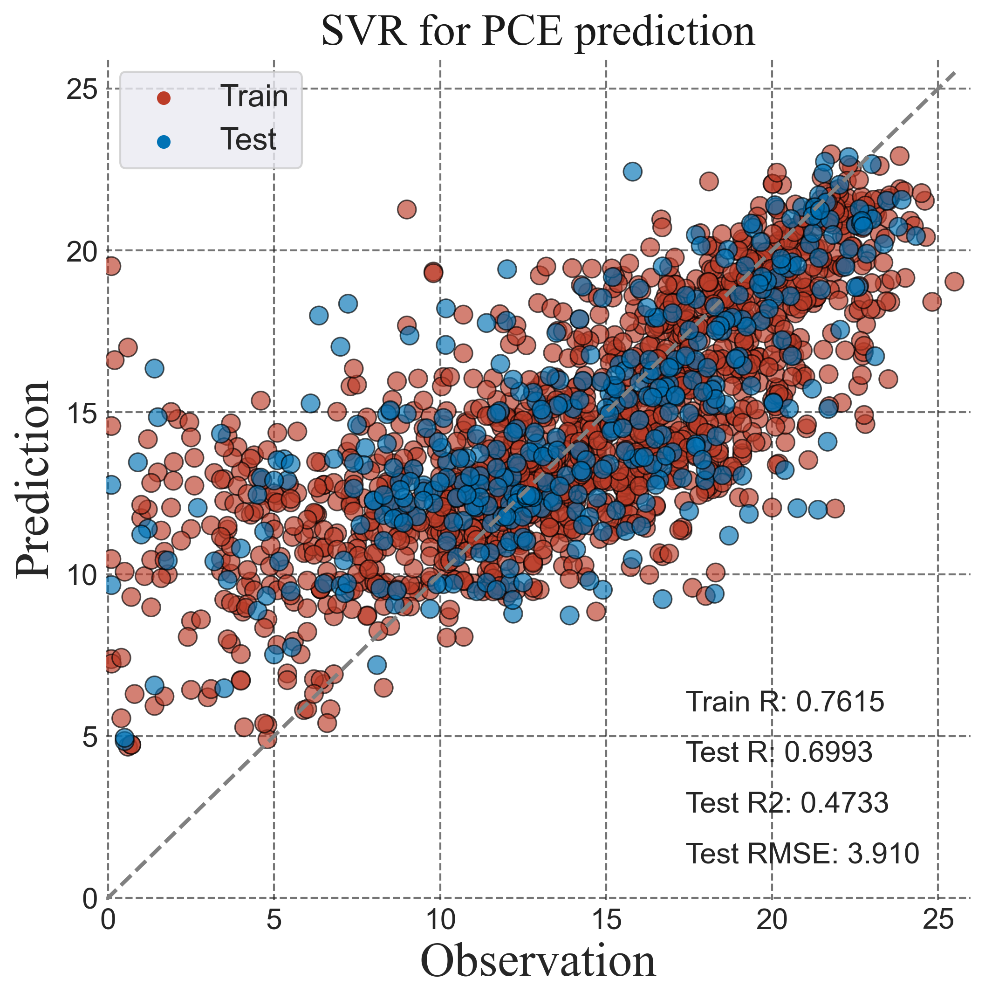

In [11]:
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot
# Initialize SVR
svr = SVR()
svr.fit(x_train, y_train)

y_test_hat_svr = svr.predict(x_test)
y_train_hat_svr = svr.predict(x_train)

myscatterplot(y_train, y_train_hat_svr, y_test, y_test_hat_svr, 'SVR', plot_height=8, picname='SVR noYear')

Best parameters: {'C': 10, 'degree': 2, 'epsilon': 0.5, 'kernel': 'rbf'}
Train R2: 0.6803323261172766
Train RMSE: 3.1037761941858273
Train MAE: 2.119084029402655
Test MAE: 2.8529995158682815


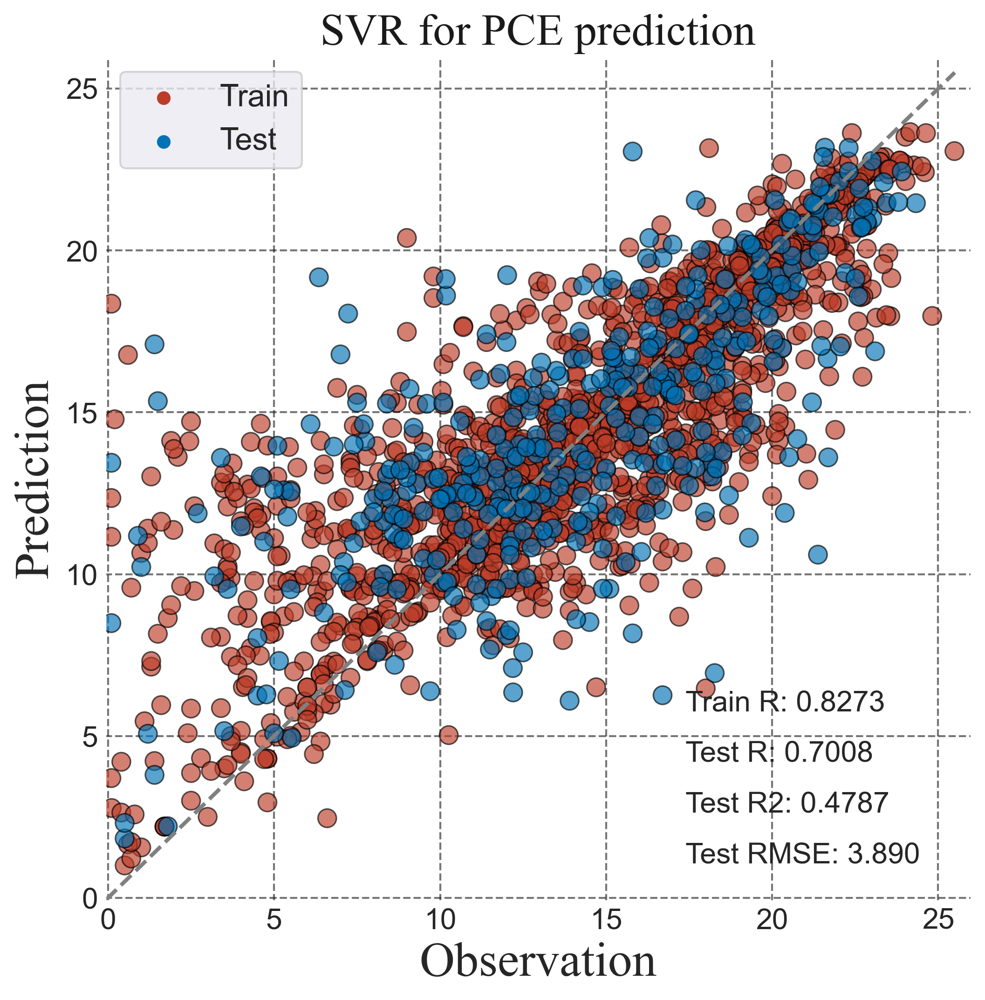

In [12]:
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

# SVR
param_grid = {
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'C': [0.1, 1, 10, 100],
    'epsilon': [0.01, 0.1, 0.2, 0.5],
    'degree': [2, 3, 4]  # Only relevant for 'poly' kernel
}


svr = SVR()
grid_search_svr = GridSearchCV(estimator=svr, param_grid=param_grid, cv=5, n_jobs=-1)


grid_search_svr.fit(x_train, y_train)

# Get the best model
best_svr = grid_search_svr.best_estimator_
print("Best parameters:", grid_search_svr.best_params_)


y_test_hat_svr = best_svr.predict(x_test)
y_train_hat_svr = best_svr.predict(x_train)

myscatterplot(y_train, y_train_hat_svr, y_test, y_test_hat_svr, 'SVR', plot_height=8, savepic=False, picname='SVR noYear')
# save_arrays_with_nan(y_train.values,y_train_hat_svr,y_test.values,y_test_hat_svr,'SVR')

### DT

Train R2: 0.9996692435966802
Train RMSE: 0.09936750243632646
Train MAE: 0.007700431355049828
Test MAE: 2.680268218821971


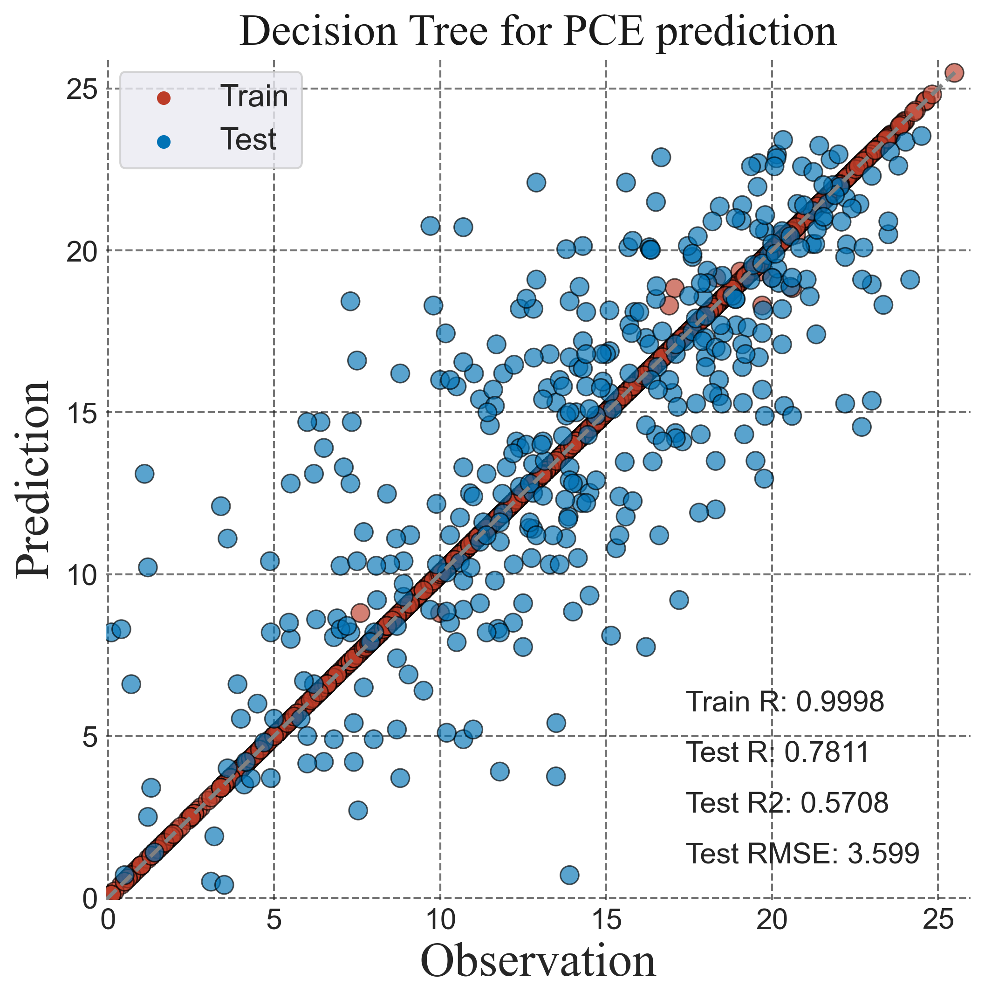

In [13]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state= 4156)

dt = DecisionTreeRegressor()
dt.fit(X_train, y_train)

y_test_hat_dt = dt.predict(X_test)
y_train_hat_dt = dt.predict(X_train)

myscatterplot(y_train, y_train_hat_dt, y_test, y_test_hat_dt, 'Decision Tree', plot_height=8, picname='Decision Tree noYear')

Best parameters: {'criterion': 'friedman_mse', 'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 2, 'splitter': 'best'}
Train R2: 0.7304215809401524
Train RMSE: 2.8368266933710293
Train MAE: 2.113232498345032
Test MAE: 2.7281685861846494


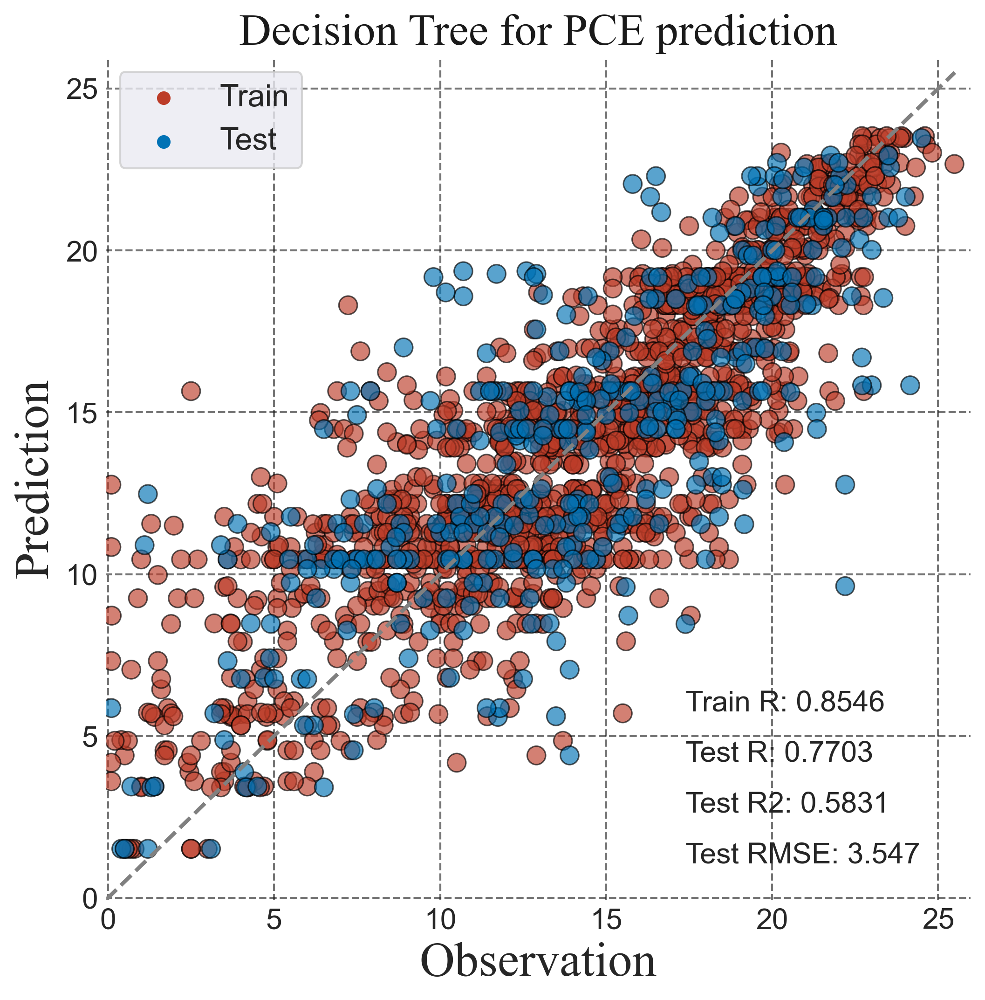

In [14]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

# DecisionTreeRegressor
param_grid_dt = {
    'criterion': ['mse', 'friedman_mse', 'mae'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

dt = DecisionTreeRegressor()
grid_search_dt = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5, n_jobs=-1)

grid_search_dt.fit(X_train, y_train)
best_dt = grid_search_dt.best_estimator_

print("Best parameters:", grid_search_dt.best_params_)

y_test_hat_dt = best_dt.predict(X_test)
y_train_hat_dt = best_dt.predict(X_train)
myscatterplot(y_train, y_train_hat_dt, y_test, y_test_hat_dt, 'Decision Tree', plot_height=8, picname='Decision Tree noYear')
# save_arrays_with_nan(y_train.values,y_train_hat_dt,y_test.values,y_test_hat_dt,'DT')

## LGBM

Train R2: 0.8351176367540125
Train RMSE: 2.218591503960486
Train MAE: 1.6597544260597443
Test MAE: 2.222263807423933


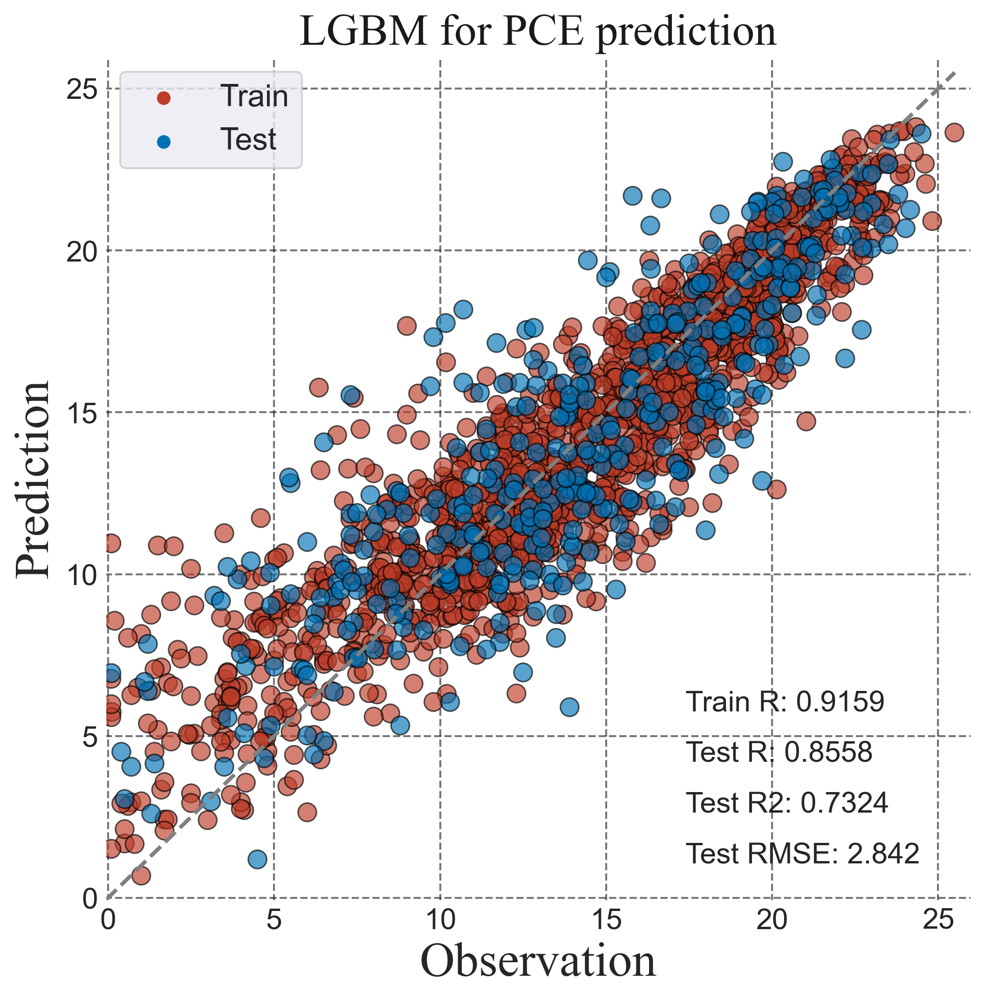

In [15]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from lightgbm import LGBMRegressor
from letsplot import myscatterplot

lgbm = LGBMRegressor(random_state=42)
lgbm.fit(X_train, y_train)
y_test_hat = lgbm.predict(X_test)
y_train_hat = lgbm.predict(X_train)
myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'LGBM',plot_height = 8, picname =  'LGBM noYear')
# save_arrays_with_nan(y_train.values,y_train_hat_svr,y_test.values,y_test_hat_svr,'LGBMbefore')

Best parameters: {'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 500, 'num_leaves': 10}
Train R2: 0.8443816937790368
Train RMSE: 2.1553638066137006
Train MAE: 1.5847383078637722
Test MAE: 2.159146594600422


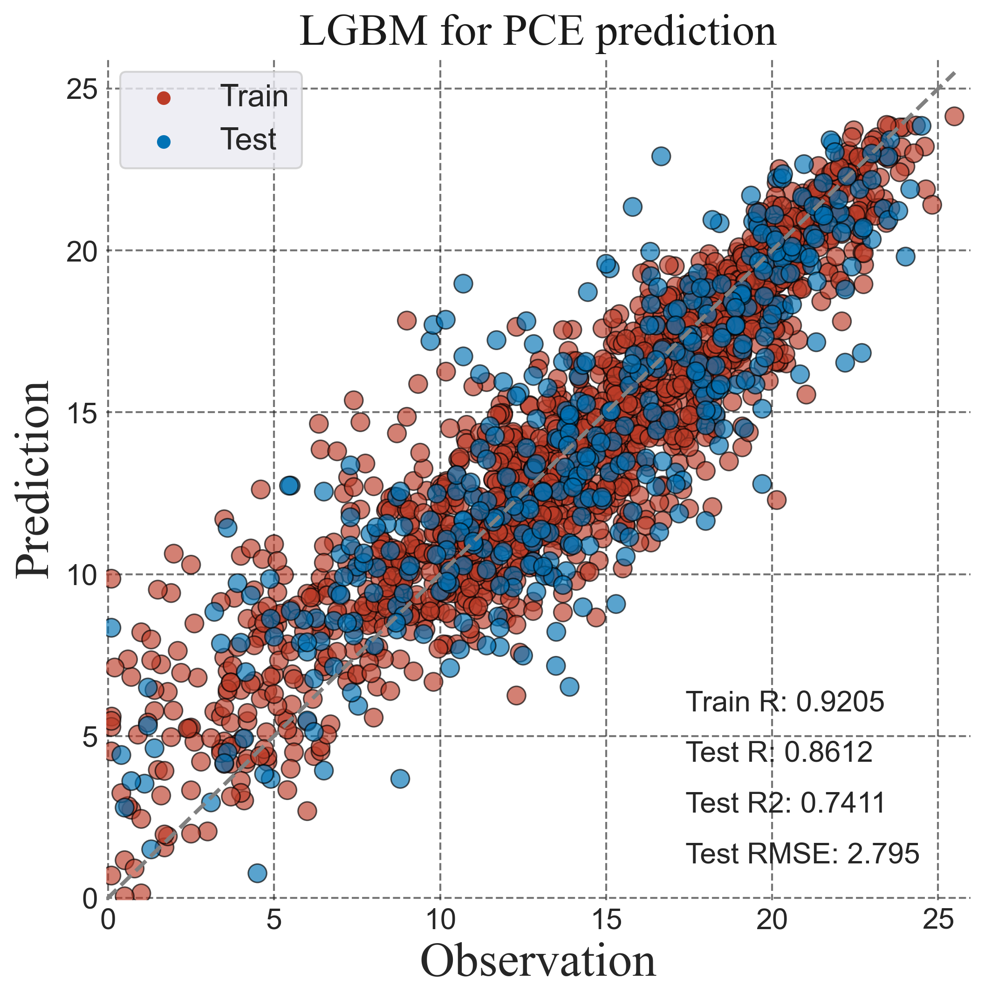

In [16]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from lightgbm import LGBMRegressor
from letsplot import myscatterplot


lgbm = LGBMRegressor(random_state=42)

param_grid = {
    'n_estimators': [500, 800, 1000],
    'learning_rate': [0.01, 0.1, 0.2],
    'num_leaves': [10, 15],
    'max_depth': [5, 10, None]
}

grid_lgbm = GridSearchCV(estimator=lgbm, param_grid=param_grid, cv=10, scoring='neg_mean_squared_error')
grid_lgbm.fit(X_train, y_train)

print("Best parameters:", grid_lgbm.best_params_)
lgbm = LGBMRegressor(**grid_lgbm.best_params_, random_state=42) 
lgbm.fit(X_train, y_train)

y_test_hat = lgbm.predict(X_test)
y_train_hat = lgbm.predict(X_train)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'LGBM',plot_height = 8, picname =  'LGBM noYear')

In [17]:
# Tree SHAP

import shap
import pandas as pd

def saveimportance(model,name):

    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)

    feature_importance = pd.DataFrame(abs(shap_values).mean(axis=0), columns=["Feature Importance"])
    feature_importance.index = X.columns
    feature_importance.to_csv("feature_importance({}).csv".format(name))
    shap.summary_plot(shap_values, X, plot_type="bar", show = False)

lgbm = LGBMRegressor(**grid_lgbm.best_params_)
lgbm.fit(X, Y)
# saveimportance(lgbm,'LGBM')

LGBMRegressor(max_depth=10, n_estimators=500, num_leaves=10)

## RF

Train R2: 0.9468772110427063
Train RMSE: 1.2593042745725092
Train MAE: 0.9410932157645445
Test MAE: 2.1325053999150274


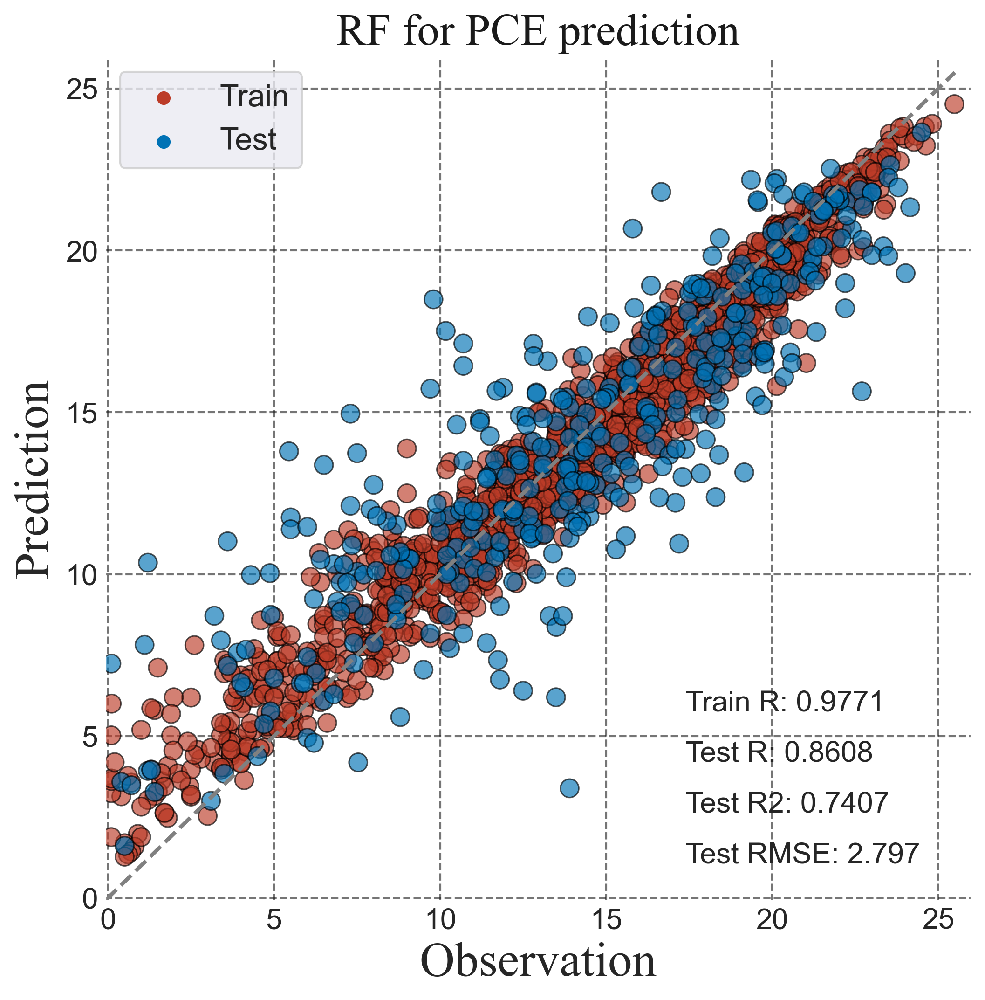

In [18]:
rf_regressor = RandomForestRegressor(random_state=42)
rf_regressor.fit(X_train, y_train)
y_train_hat = rf_regressor.predict(X_train)
y_test_hat = rf_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'RF',plot_height = 8, picname =  'RF noYear')
save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'RFbefore')

In [19]:
from sklearn.model_selection import GridSearchCV

# RF
regressor = RandomForestRegressor()

params = {
    'n_estimators': [800, 1000, 1200],
    'max_depth': [10, 20, None],
    'min_samples_split': [3, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(regressor, param_grid=params, cv=10, n_jobs = -1)
grid_search.fit(X_train, y_train)

print('Best parameters:', grid_search.best_params_)
print('Best score:', grid_search.best_score_)

Best parameters: {'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 1200}
Best score: 0.6148986819070564


Train R2: 0.9012437813828785
Train RMSE: 1.7170085982508445
Train MAE: 1.2975048554811355
Test MAE: 2.1322068342367815


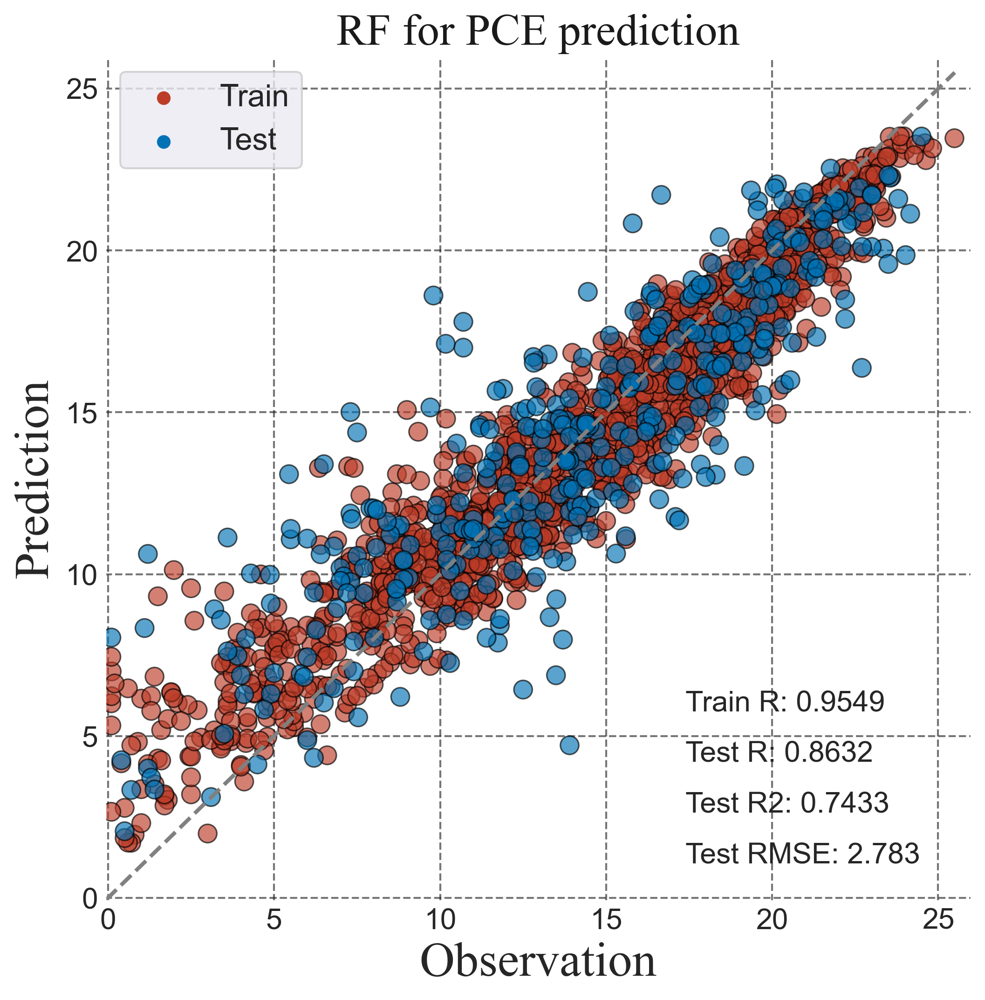

In [20]:
from sklearn.model_selection import train_test_split
from letsplot import myscatterplot
from sklearn.ensemble import RandomForestRegressor

rf_regressor = RandomForestRegressor(**{'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 800}, random_state=42)

rf_regressor.fit(X_train, y_train)
y_train_hat = rf_regressor.predict(X_train)
y_test_hat = rf_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'RF',plot_height = 8, picname =  'RF noYear')
save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'RF')

In [21]:
rf_regressor = RandomForestRegressor(**grid_search.best_params_)
rf_regressor.fit(X, Y)
# saveimportance(rf_regressor,'RF')

RandomForestRegressor(min_samples_leaf=2, min_samples_split=3,
                      n_estimators=1200)

## XGB

Train R2: 0.935379805945538
Train RMSE: 1.3889108568134056
Train MAE: 0.9553183370430548
Test MAE: 2.070936651445293


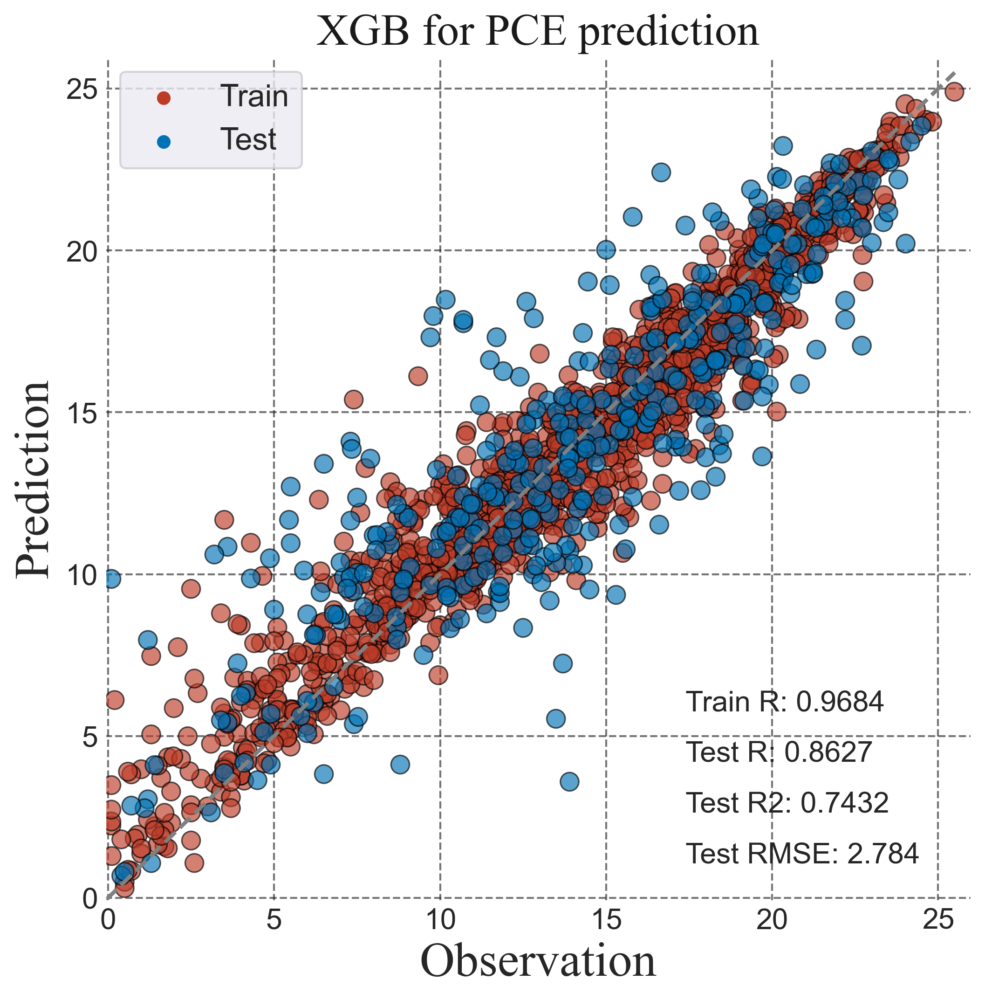

In [22]:
import xgboost as xgb
xgb_reg = xgb.XGBRegressor(random_state=42)
xgb_reg.fit(X_train, y_train)
y_train_hat = xgb_reg.predict(X_train)
y_test_hat = xgb_reg.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'XGB',plot_height = 8, picname =  'XGB noYear')
save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'XGBbefore')

The base model's RMSE is: 3.9069990970238426
The best parameters are:  {'learning_rate': 0.02, 'max_depth': 7, 'n_estimators': 500}
The best score is:  3.674532505222003
The best model's RMSE is: 3.8039138687280456
Train R2: 0.8804517754250292
Train RMSE: 1.889129844839525
Train MAE: 1.3517133719915255
Test MAE: 2.055341297624761


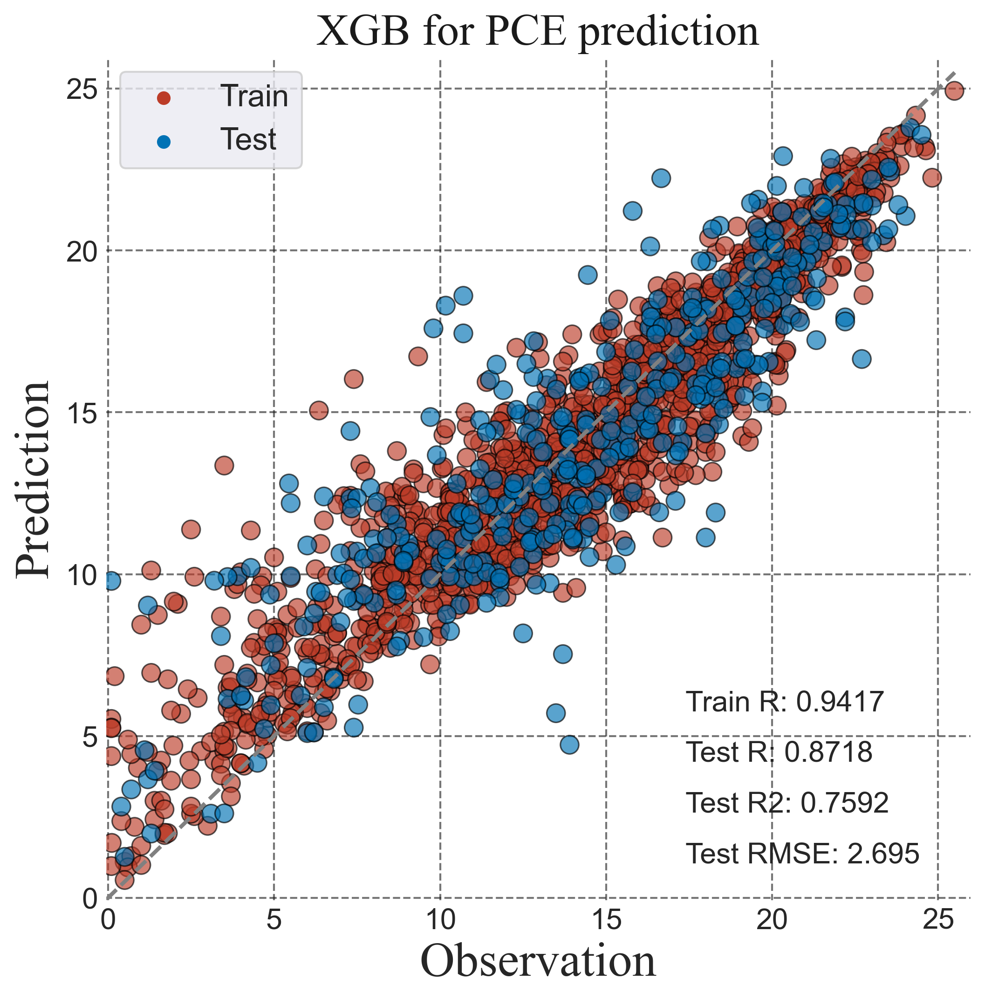

In [23]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score, GridSearchCV
import pandas as pd

# XGB Base RMSE
xgb_reg = xgb.XGBRegressor(random_state=42)
scores = cross_val_score(xgb_reg, X, Y, cv=5, scoring='neg_mean_squared_error')
rmse = (-scores.mean())**(1/2)
print("The base model's RMSE is:", rmse)

param_grid = {'n_estimators': [1000, 500, 700],
                'max_depth': [  7, 10 ],
                'learning_rate': [0.05, 0.1, 0.02]}
grid_search_XGb = GridSearchCV(xgb_reg, param_grid, cv=10, scoring='neg_mean_squared_error')
grid_search_XGb.fit(X, Y)

print("The best parameters are: ", grid_search_XGb.best_params_)
print("The best score is: ", (-grid_search_XGb.best_score_)**(1/2))

xgb_reg_best = xgb.XGBRegressor(**grid_search_XGb.best_params_, random_state=42)
scores_best = cross_val_score(xgb_reg_best, X, Y, cv=5, scoring='neg_mean_squared_error')
rmse_best = (-scores_best.mean())**(1/2)
print("The best model's RMSE is:", rmse_best)

xgb_reg_best = xgb.XGBRegressor(**grid_search_XGb.best_params_, random_state=42)

xgb_reg_best.fit(X_train, y_train)
y_train_hat = xgb_reg_best.predict(X_train)
y_test_hat = xgb_reg_best.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'XGB',plot_height = 8, savepic = True, picname =  'XGB noYear')
save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'XGB')

In [24]:
xgb_reg_best = xgb.XGBRegressor(**grid_search_XGb.best_params_, random_state=42)
xgb_reg_best.fit(X, Y)
# saveimportance(xgb_reg_best,'XGB')

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.02, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=7, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=500, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, ...)

## CB

In [25]:
catcol = ['ETL', 'ETL-2','HTL','HTL_additive', 'Perovskite_deposition_procedure',
       'Perovskite_deposition_method', 'Antisolvent', 'Precursor_solution',
        'ETL_Passivator', 'HTL_Passivator', 'Additive', 'Use_Cl',]

In [26]:
X_train[catcol] = X_train[catcol].astype('int')
X_test[catcol] = X_test[catcol].astype('int')


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [27]:
from catboost import CatBoostRegressor
import matplotlib.pyplot as plt
params = {
        'learning_rate':[0.07,0.08,0.09,0.1],
        'early_stopping_rounds':[2000,1500,1000],
        'depth':[5,7,9,10],
        }

cb_regressor = CatBoostRegressor(random_seed=42,cat_features=catcol,loss_function='RMSE',task_type="GPU",silent=True) 
grid_search_result = cb_regressor.grid_search(params, X=X_train, y=y_train, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

bestTest = 3.243545943
bestIteration = 867
0:	loss: 3.2435459	best: 3.2435459 (0)	total: 19.7s	remaining: 15m 24s
bestTest = 3.240443928
bestIteration = 937
1:	loss: 3.2404439	best: 3.2404439 (1)	total: 39.3s	remaining: 15m 4s
bestTest = 3.225821478
bestIteration = 558
2:	loss: 3.2258215	best: 3.2258215 (2)	total: 57.2s	remaining: 14m 17s
bestTest = 3.264821285
bestIteration = 437
3:	loss: 3.2648213	best: 3.2258215 (2)	total: 1m 15s	remaining: 13m 50s
bestTest = 3.243545943
bestIteration = 867
4:	loss: 3.2435459	best: 3.2258215 (2)	total: 1m 33s	remaining: 13m 25s
bestTest = 3.240443928
bestIteration = 937
5:	loss: 3.2404439	best: 3.2258215 (2)	total: 1m 55s	remaining: 13m 26s
bestTest = 3.225821478
bestIteration = 558
6:	loss: 3.2258215	best: 3.2258215 (2)	total: 2m 26s	remaining: 14m 16s
bestTest = 3.264821285
bestIteration = 437
7:	loss: 3.2648213	best: 3.2258215 (2)	total: 2m 57s	remaining: 14m 49s
bestTest = 3.243545943
bestIteration = 867
8:	loss: 3.2435459	best: 3.2258215 (2)	to

Train R2: 0.7381652320434786
Train RMSE: 2.795785839523166
Train MAE: 2.1388187614163185
Test MAE: 2.1726629031883715


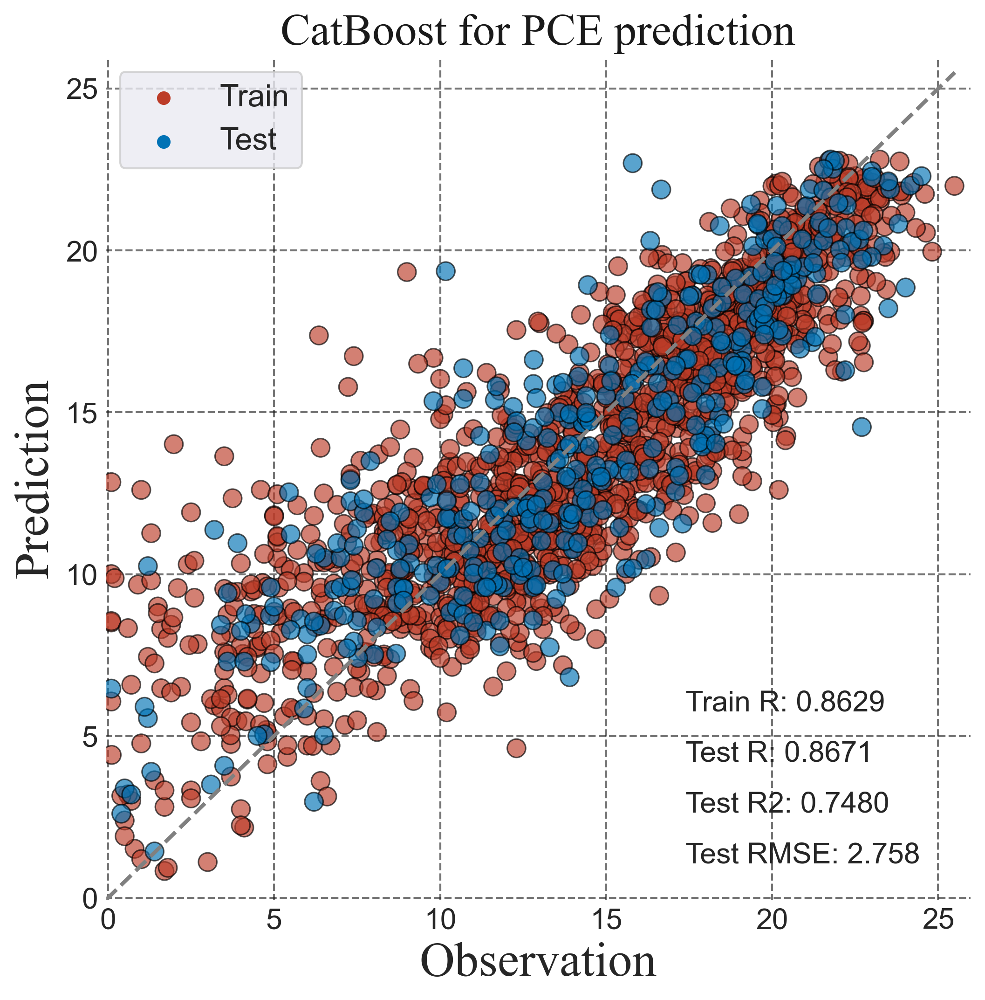

In [28]:
from catboost import CatBoostRegressor
cb_regressor = CatBoostRegressor(cat_features=catcol,random_seed=42,task_type="GPU", silent=True)
cb_regressor.fit(X_train, y_train)
y_train_hat = cb_regressor.predict(X_train)
y_test_hat = cb_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'CatBoost',plot_height = 8, picname = 'CatBoost noYear')
save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'CBbefore')

Train R2: 0.8803932864265255
Train RMSE: 1.8895919169516195
Train MAE: 1.363799172542575
Test MAE: 2.077514357861174


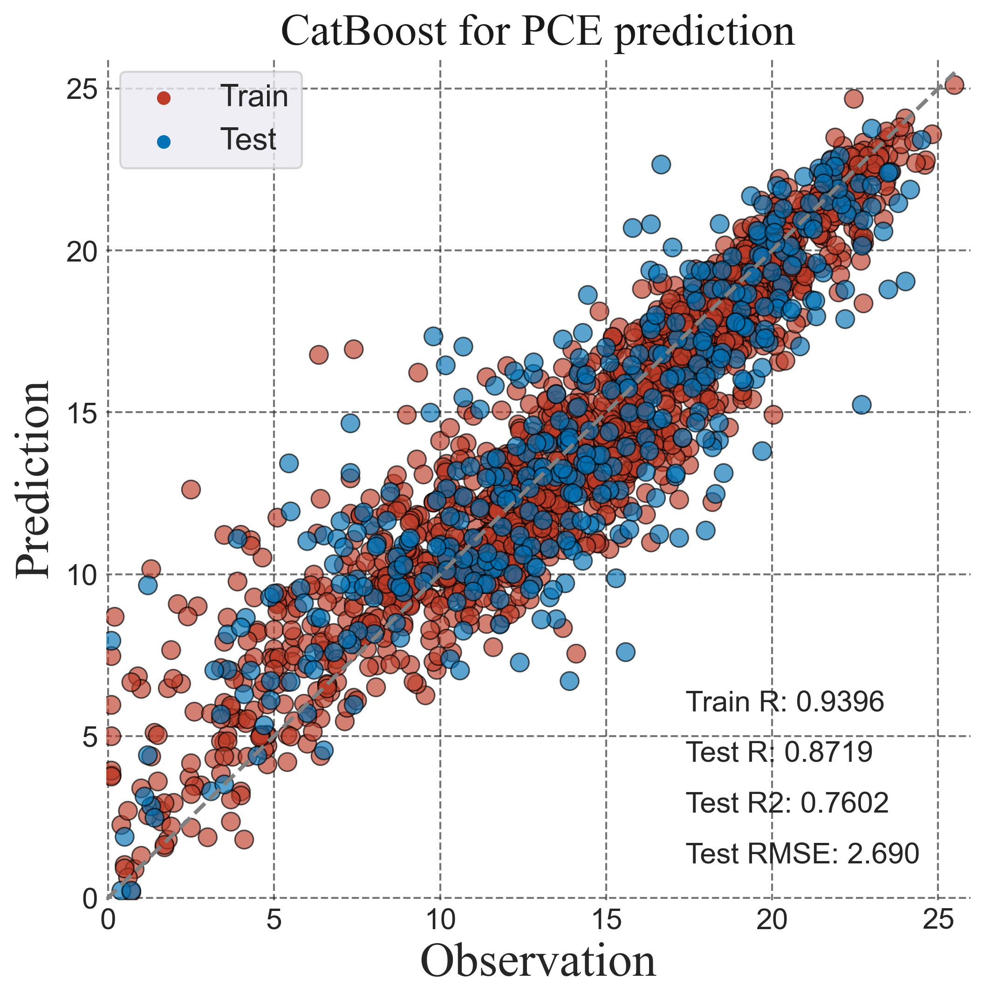

In [29]:
from catboost import CatBoostRegressor
cb_regressor = CatBoostRegressor(**{'boosting_type': 'Ordered','one_hot_max_size':255 ,'depth': 7,'iterations': 5000, 'l2_leaf_reg': 3, 'learning_rate': 0.09,'loss_function': 'RMSE'},
                                 cat_features=catcol,early_stopping_rounds=1500,random_seed=42,task_type="GPU", silent=True)
cb_regressor.fit(X_train, y_train)
y_train_hat = cb_regressor.predict(X_train)
y_test_hat = cb_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'CatBoost',plot_height = 8, picname = 'CatBoost noYear')
save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'CB')

In [30]:
cb_regressor = CatBoostRegressor(**{'boosting_type': 'Ordered','one_hot_max_size':255 ,'depth': 7,'iterations': 5000, 'l2_leaf_reg': 3, 'learning_rate': 0.08,'loss_function': 'RMSE'},
                                 cat_features=catcol,early_stopping_rounds=1000,random_seed=42,task_type="GPU", silent=True)
cb_regressor.fit(X, Y)
# saveimportance(cb_regressor,'CB')

## SHAP

In [31]:
import shap
import pandas as pd
import matplotlib.pyplot as plt

explainer_cb = shap.TreeExplainer(cb_regressor)  
shap_values_cb = explainer_cb.shap_values(X)

In [32]:
explainer_xgb = shap.TreeExplainer(xgb_reg_best) 
shap_values_xgb = explainer_xgb.shap_values(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


In [33]:
explainer_rf = shap.TreeExplainer(rf_regressor)  
shap_values_rf = explainer_rf.shap_values(X)

In [34]:
explainer_lgbm = shap.TreeExplainer(lgbm)  
shap_values_lgbm = explainer_lgbm.shap_values(X)

In [35]:
stacked_arrays = np.stack([shap_values_cb, shap_values_xgb, shap_values_rf, shap_values_lgbm])

average_shap_values = np.mean(stacked_arrays, axis=0)
average_shap_values

array([[ 1.46895779, -0.04134762, -0.01671533, ...,  0.10996496,
         0.07571544,  0.3587594 ],
       [-0.61016299, -0.09749899, -0.11222985, ...,  0.10194969,
         0.07411401,  0.28992611],
       [ 1.18599594,  0.68071617, -0.03327363, ...,  0.08141515,
         0.11958221,  0.77913423],
       ...,
       [-0.51613542,  0.47452026, -0.04508092, ...,  0.11167864,
         0.07538511,  0.30570805],
       [-1.57195599, -0.30215848, -0.09903597, ...,  0.03592991,
         0.05265777,  0.26327191],
       [-0.77336474, -0.25864   , -0.06880672, ...,  0.08738745,
         0.06509173,  0.28510373]])

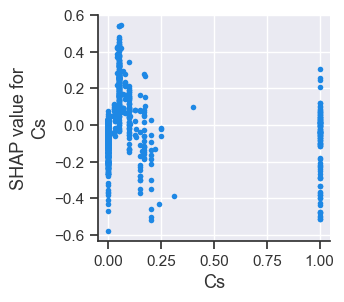

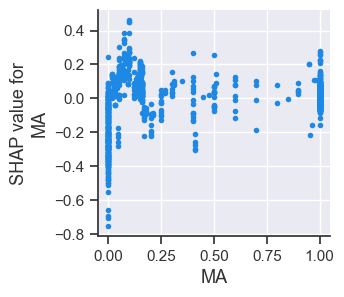

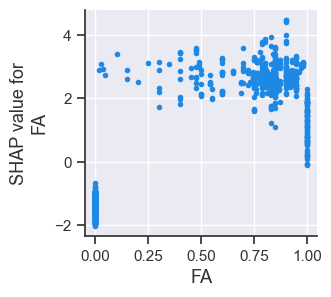

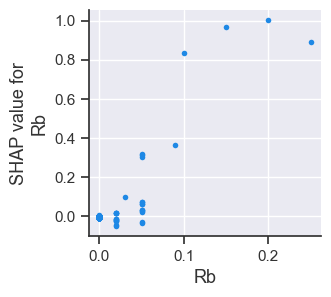

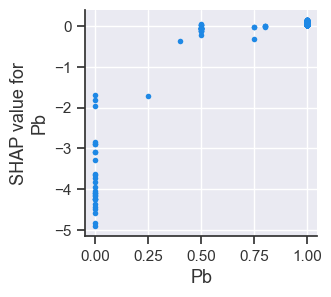

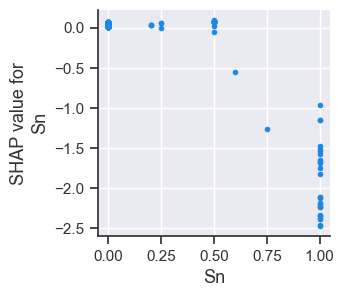

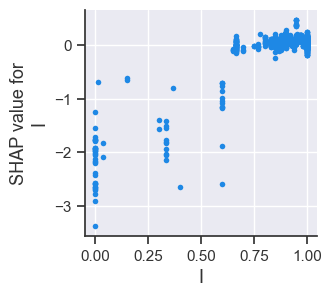

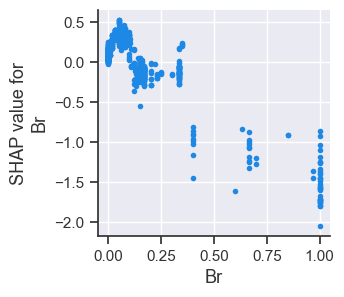

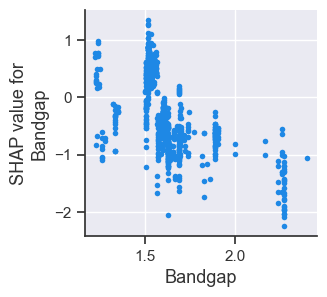

In [36]:
import pandas as pd
import shap
import matplotlib.pyplot as plt

df_X = pd.DataFrame(X)
plt.rcParams['font.sans-serif'] = ["Arial"]
data_dfs = [] 

for name in df_X.columns[12:]:
    fig, ax = plt.subplots(1, 1, figsize=(3, 3), dpi=100)
    ax.set_ylabel('SHAP value',)
    shap.dependence_plot(name, average_shap_values, X, display_features=X, interaction_index=None, ax=ax, show=False)
    
    scatter_data = ax.collections[0].get_offsets()    

    data_single_df = pd.DataFrame(scatter_data, columns=['{}_Feature_Value'.format(name), '{}_SHAP_Value'.format(name)])
    data_dfs.append(data_single_df)  

data_df = pd.concat(data_dfs, axis=1)

In [37]:
# data_df.to_csv("SHAPavg.csv")
data_df

,Cs_Feature_Value,Cs_SHAP_Value,MA_Feature_Value,MA_SHAP_Value,FA_Feature_Value,FA_SHAP_Value,Rb_Feature_Value,Rb_SHAP_Value,Pb_Feature_Value,Pb_SHAP_Value,Sn_Feature_Value,Sn_SHAP_Value,I_Feature_Value,I_SHAP_Value,Br_Feature_Value,Br_SHAP_Value,Bandgap_Feature_Value,Bandgap_SHAP_Value
0,0.05,0.281271,0.0475,-0.226023,0.54,2.723454,0.0,-0.004052,1.0,0.096871,0.0,0.043268,1.00,0.109037,0.052000,0.399560,1.686143,-0.502155
1,0.05,0.427203,0.6000,-0.010640,0.00,-1.799173,0.0,-0.004657,1.0,0.051723,0.0,0.044059,1.00,0.049911,0.000000,0.036258,1.530114,0.364746
2,1.00,-0.238174,1.0000,0.044495,0.00,-1.336150,0.0,-0.004672,1.0,0.051326,0.0,0.012388,1.00,0.104373,0.000000,0.105717,1.530114,0.268781
3,0.00,-0.016781,0.1615,0.010845,0.94,2.512482,0.0,-0.004863,1.0,0.057455,0.0,0.025311,0.95,0.045642,0.066667,0.289903,1.530114,0.359128
4,0.00,-0.028880,0.0000,-0.370766,0.00,-1.346922,0.0,-0.006213,1.0,0.044298,0.0,0.030527,1.00,0.037169,0.000000,0.062202,1.586253,-0.676279
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1863,0.15,-0.301268,0.0000,-0.084068,0.00,-1.438294,0.0,-0.003983,1.0,0.050910,0.0,0.026105,0.95,0.117664,0.333333,-0.071477,1.517405,0.685445
1864,0.00,-0.027390,0.0000,-0.349015,0.00,-1.208224,0.0,-0.004162,1.0,0.099139,0.0,0.026360,0.85,0.027685,0.000000,0.056206,1.509450,-0.040742
1865,0.00,-0.048169,1.0000,0.228496,0.00,-1.329190,0.0,-0.003670,1.0,0.088689,0.0,0.030246,1.00,0.040576,0.000000,0.058586,1.597491,-0.556164
1866,0.05,-0.031782,0.0000,-0.341049,0.00,-1.593450,0.0,-0.003810,1.0,0.046810,0.0,0.032528,1.00,0.030578,0.333333,-0.068734,1.530114,0.333428
